In [2]:
import numpy as np
from bmtk.analyzer.spike_trains import to_dataframe
import matplotlib.pyplot as plt
import os

In [1]:
print("hello world")

hello wpr;d


In [4]:
%ls -a

./                       my_configs/    Report-2743666.out  scripts/
../                      my_results/    Report-2743668.out  slurm_scripts/
configs/                 my_stimulus/   Report-2743669.out  Untitled.ipynb
.ipynb_checkpoints/      network/       Report-2743671.out
lgn_stimulus.zip         output_files/  results/
make_filternet_plots.py  plots/         run_filternet.py*


In [6]:
#
full_lgn_spikes_trial_0 = to_dataframe(config_file=None, spikes_file='../pointnet_v1/lgn_stimulus/full3_production_3.0sec_SF0.04_TF2.0_ori315.0_c80.0_gs0.5/spikes.trial_0.h5')
full_lgn_spikes_trial_0

,timestamps,node_ids,population
0,324.253031,0,lgn
1,517.288008,0,lgn
2,1023.792238,0,lgn
3,1846.014790,0,lgn
4,2432.392551,0,lgn
...,...,...,...
297616,2613.208320,17399,lgn
297617,2633.002210,17399,lgn
297618,2705.985536,17399,lgn
297619,2708.467047,17399,lgn


(0, 3000)


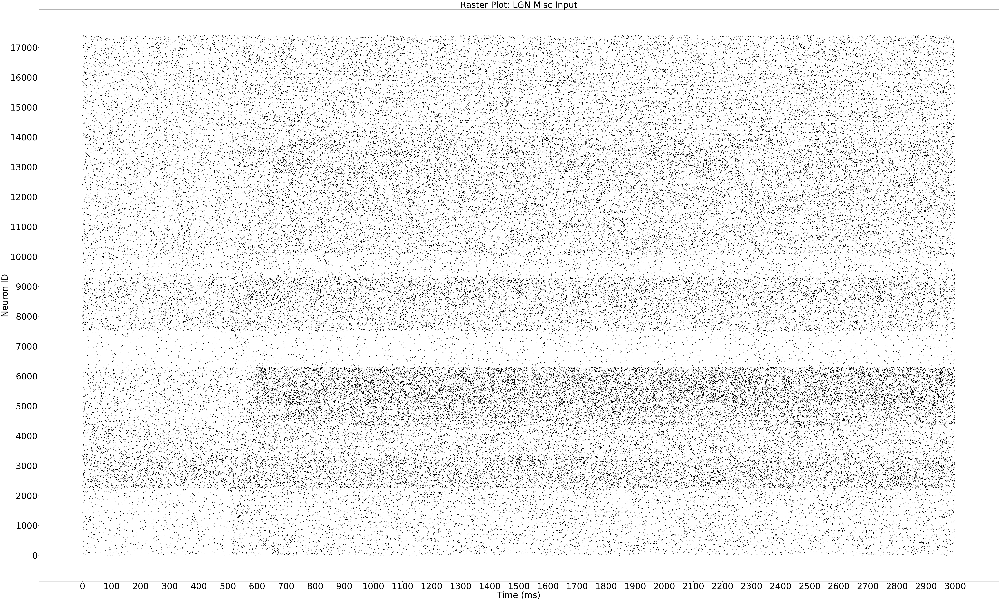

In [7]:
raster_plot_scatter(df=full_lgn_spikes_trial_0, title='Raster Plot: LGN Misc Input',
                   save_dir='./plots/lgn_other/',
                       save_title='lgn_misc.png')

In [4]:
lgn_flicker_df_1 = to_dataframe(config_file='./my_results/lgn_flicker_1/config_flicker_1.json', spikes_file='./my_results/lgn_flicker_1/spikes.h5')

In [5]:
lgn_flicker_df_1

,timestamps,node_ids,population
0,441.419058,0,lgn
1,617.779497,0,lgn
2,1113.148181,0,lgn
3,1839.134674,0,lgn
4,1922.879425,0,lgn
...,...,...,...
205316,403.153161,17399,lgn
205317,285.436971,17399,lgn
205318,2435.184653,17399,lgn
205319,1284.559901,17399,lgn


In [13]:
def raster_plot_scatter(df, title='Raster Plot (Scatter)',
                       save_dir=None,
                       save_title=None):
    """
    Create a basic raster plot using scatter. 
    df must have 'timestamps' and 'node_ids' columns.
    """
    
    timestamps_min = int(np.round(df['timestamps'].min(), -2))
    timestamps_max = int(np.round(df['timestamps'].max(), -2))
    print((timestamps_min, timestamps_max))
    
    neuron_id_min = int(np.round(df['node_ids'].min(), -2))
    neuron_id_max = int(np.round(df['node_ids'].max(), -2))
    
    fig, ax = plt.subplots(figsize=(100, 60))

    # Plot each spike as a vertical marker
    ax.scatter(
        df['timestamps'],
        df['node_ids'],
        s=5,               # marker size
        marker='|',        # vertical line marker
        #s=1,               # marker size
        #marker=',',        # vertical line marker
        color='black'
    )

    ax.set_xlabel('Time (ms)', fontsize=50)
    ax.set_ylabel('Neuron ID', fontsize=50)
    ax.set_title(title, fontsize=50)
    
    timestamp_ticks=np.arange(timestamps_min,timestamps_max+100,100)
    ax.set_xticks(timestamp_ticks)
    ax.set_xticklabels(timestamp_ticks, fontsize=50)
    
    n_neurons = neuron_id_max
    if n_neurons < 20000:
        neuron_tick_increment = 1000
    if n_neurons > 200000:
        neuron_tick_increment = 20000
        
    
    neuron_ticks=np.arange(neuron_id_min, neuron_id_max+100,neuron_tick_increment)
    ax.set_yticks(neuron_ticks)
    ax.set_yticklabels(neuron_ticks, fontsize=50)
    
    plt.show()
    
    if save_dir is not None and save_title is not None:
        if not os.path.isdir(save_dir):
            os.makedirs(save_dir)

        fig.savefig(save_dir + save_title)
"""
raster_plot_scatter(df=lgn_flicker_df_1, title='Raster Plot: LGN 10hz Flicker Stimulus 0 background 10ms Active',
                   save_dir='./plots/lgn_flicker_1/',
                       save_title='all_inclusive_lgn_flicker.png')
"""

"\nraster_plot_scatter(df=lgn_flicker_df_1, title='Raster Plot: LGN 10hz Flicker Stimulus 0 background 10ms Active',\n                   save_dir='./plots/lgn_flicker_1/',\n                       save_title='all_inclusive_lgn_flicker.png')\n"

In [4]:
def firing_rate_heatmap_with_neuron_bins(df,
                                         time_bin_size=10,
                                         neuron_bin_size=50,
                                         time_max=None,
                                        fontsize=70,  
                                         figsize=(100,60),
                                         title='',
                                         save_dir=None,
                       save_title=None):
    """
    Create a 2D heatmap of spike counts (or firing rate), 
    by binning both in time and neuron IDs.

    :param df:          DataFrame with 'timestamps' (ms) and 'node_ids'
    :param time_bin_size:    Size of each time bin in ms (e.g. 10 ms)
    :param neuron_bin_size:  Number of neurons per bin (e.g. 50)
    :param time_max:         If None, use max timestamps in df; otherwise a cutoff
    """
    timestamps_min = int(np.round(df['timestamps'].min(), -2))
    timestamps_max = int(np.round(df['timestamps'].max(), -2))
    print((timestamps_min, timestamps_max))
    
    neuron_id_min = int(np.round(df['node_ids'].min(), -2))
    neuron_id_max = int(np.round(df['node_ids'].max(), -2))
    # 1) Possibly limit time range
    if time_max is None:
        time_max = df['timestamps'].max()

    print("THIS SCRIPT HAS AN ERROR:")
    print("you need to renormalize the spike bins by dividing by what you thought you were dividing by")
    assert(False)
    
    # 2) Create a time-bin index (integer) for each spike
    df['time_bin'] = (df['timestamps'] // time_bin_size).astype(int)

    #
    # 3) Create a neuron-bin index (integer) for each spike
    #    E.g. node_ids 1-50 → bin 0, 51-100 → bin 1, etc.
    df['neuron_bin'] = (df['node_ids'] - 1) // neuron_bin_size

    # 4) Group by (neuron_bin, time_bin) → count spikes
    grouped = (df.groupby(['neuron_bin', 'time_bin'])
                 .size()
                 .reset_index(name='spike_count'))

    # 5) Pivot to get a 2D matrix: rows = neuron_bin, columns = time_bin
    heatmap_df = grouped.pivot(index='neuron_bin',
                               columns='time_bin',
                               values='spike_count').fillna(0)

    # Optionally convert spike_count → rate (spikes / second), for example:
    # heatmap_df = heatmap_df / (time_bin_size / 1000.0)  # if time_bin_size is ms

    # 6) Sort indices so the bins appear in ascending order
    heatmap_df = heatmap_df.sort_index(axis=0)
    heatmap_df = heatmap_df.sort_index(axis=1)

    # 7) Plot via imshow (heatmap)
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(heatmap_df,
                   aspect='auto',
                   origin='lower',
                   #cmap='hot')  # 'hot', 'viridis', etc.
                   cmap='hot_r',
                  vmin=0,vmax=16)  #REVERSED HOT...REVERSES THE COLORS

    cbar = plt.colorbar(im, ax=ax,)
    cbar.set_label('Spike Count',fontsize=fontsize)
    cbar.ax.tick_params(labelsize=fontsize)

    ax.set_xlabel(f'Time Bin Index (each bin = {time_bin_size} ms)', fontsize=fontsize)
    ax.set_ylabel(f'Neuron Bin Index (each bin = {neuron_bin_size} neurons)', fontsize=fontsize)
    ax.set_title(title, fontsize=fontsize)
    ax.tick_params(axis='both',labelsize=fontsize)
    
    """
    timestamp_ticks=np.arange(timestamps_min,timestamps_max+100,100)
    ax.set_xticks(timestamp_ticks)
    ax.set_xticklabels(timestamp_ticks, fontsize=50)
    
    neuron_ticks=np.arange(neuron_id_min, neuron_id_max+100,1000)
    ax.set_yticks(neuron_ticks)
    ax.set_yticklabels(neuron_ticks, fontsize=50)
    """
    
    plt.tight_layout()
    plt.show()
    
    if save_dir is not None and save_title is not None:
        if not os.path.isdir(save_dir):
            os.makedirs(save_dir)
        fig.savefig(save_dir + save_title)
        
    
    return fig, heatmap_df

"""
fig, hm_data = firing_rate_heatmap_with_neuron_bins(df=lgn_flicker_df_1,
                                                     time_bin_size=10,
                                                     neuron_bin_size=70,
                                                    figsize=(100,60),
                                                    save_dir='./plots/lgn_flicker_1/',
                                                    save_title='all_lgn_flicker_heatmap_large.png',
                                                    title='Firing Rate Heatmap: LGN 10hz Flicker Stimulus 0 background 10ms Active'
                                                    
                                                   )
"""

"\nfig, hm_data = firing_rate_heatmap_with_neuron_bins(df=lgn_flicker_df_1,\n                                                     time_bin_size=10,\n                                                     neuron_bin_size=70,\n                                                    figsize=(100,60),\n                                                    save_dir='./plots/lgn_flicker_1/',\n                                                    save_title='all_lgn_flicker_heatmap_large.png',\n                                                    title='Firing Rate Heatmap: LGN 10hz Flicker Stimulus 0 background 10ms Active'\n                                                    \n                                                   )\n"

In [ ]:
lgn_0_bg_only = to_dataframe(config_file='./my_results/.json', 
                                spikes_file='./my_results/test_lgn_1/spikes.h5')

fig, hm_data = firing_rate_heatmap_with_neuron_bins(df=lgn_flicker_df_2,
                                                    time_bin_size=10,
                                                    neuron_bin_size=70,
                                                    figsize=(100,60),
                                                    save_dir='./plots/lgn_0_background_only/',
                                                    save_title='all_lgn_bg_only_heatmap_large.png',
                                                    title='Firing Rate Heatmap: LGN 0 Background Only'
                                                    
                                                   )

raster_plot_scatter(df=lgn_flicker_df_2, title='Raster Plot: LGN 0 background Only',
                   save_dir='./plots/lgn_0_background_only/',
                       save_title='lgn_0_background_raster_plot.png')

In [ ]:
pointnet_0_bg_only = to_dataframe(config_file='../pointnet_v1/my_configs/config_flicker_sanity.json', 
                                spikes_file='../pointnet_v1/my_results/no_flicker_sanity/spikes.h5')


fig, hm_data = firing_rate_heatmap_with_neuron_bins(df=pointnet_0_bg_only,
                                                     time_bin_size=10,
                                                     neuron_bin_size=70,
                                                    figsize=(100,60),
                                                    save_dir='./plots/v1_0_background_only/',
                                                    save_title='all_v1_0_bg_only_heatmap_large.png',
                                                    title='Firing Rate Heatmap: V1 0 Background Only'
                                                    
                                                   )

raster_plot_scatter(df=pointnet_0_bg_only, title='Raster Plot: V1 0 background Only',
                   save_dir='./plots/v1_0_background_only/',
                       save_title='v1_0_background_raster_plot.png')

In [ ]:
pointnet_flicker = to_dataframe(config_file='../pointnet_v1/my_configs/config_flicker_1.json', 
                                spikes_file='../pointnet_v1/my_results/flicker_10_hz_0_1_1_sec_no_input_before_and_after/spikes.h5')

fig, hm_data = firing_rate_heatmap_with_neuron_bins(df=pointnet_flicker,
                                                     time_bin_size=10,
                                                     neuron_bin_size=70,
                                                    figsize=(100,60),
                                                    save_dir='./plots/v1_flicker_1/',
                                                    save_title='all_v1_flicker_heatmap_large.png',
                                                    title='Firing Rate Heatmap: V1 10hz Flicker Stimulus 0 background 10ms Active'
                                                    
                                                   )

raster_plot_scatter(df=pointnet_flicker, title='Raster Plot: V1 10hz Flicker Stimulus 0 background 10ms Active',
                   save_dir='./plots/v1_flicker_1/',
                       save_title='all_inclusive_v1_flicker.png')

In [ ]:
def raster_plot_eventplot(df, title='Raster Plot (Event Plot)'):
    """
    Create a raster plot using Matplotlib's eventplot.
    df must have 'timestamps' and 'node_ids' columns.
    """
    fig, ax = plt.subplots(figsize=(10, 6))

    # Get the unique neuron IDs, sorted if you want them in ascending order
    unique_node_ids = df['node_ids'].unique()
    unique_node_ids.sort()

    # Build a list of spike-time arrays, one per neuron
    spike_trains = []
    for node_id in unique_node_ids:
        spikes_for_neuron = df.loc[df['node_ids'] == node_id, 'timestamps'].values
        spike_trains.append(spikes_for_neuron)

    # Create the event plot. "lineoffsets" will place each neuron's spikes
    # at the corresponding y-axis value. If you omit lineoffsets, 
    # the spikes will be on consecutive integer lines instead.
    ax.eventplot(
        spike_trains,
        lineoffsets=unique_node_ids,  # positions along y-axis
        linelengths=0.8,              # length of each spike line
        color='black'
    )

    ax.set_xlabel('Time (ms)')
    ax.set_ylabel('Neuron ID')
    ax.set_title(title)

    plt.show()


# Example usage:
raster_plot_eventplot(df=lgn_flicker_df_1)

In [8]:
full_pointnet_spikes_trial_0 = to_dataframe(config_file=None, spikes_file=\
                                            '../pointnet_v1/output/spikes.h5')
full_pointnet_spikes_trial_0

,timestamps,node_ids,population
0,968.25,75,v1
1,1062.50,75,v1
2,1469.50,75,v1
3,1606.75,75,v1
4,1965.25,75,v1
...,...,...,...
1446631,2182.25,230780,v1
1446632,2410.25,230780,v1
1446633,2559.00,230780,v1
1446634,2727.25,230780,v1


(0, 3000)


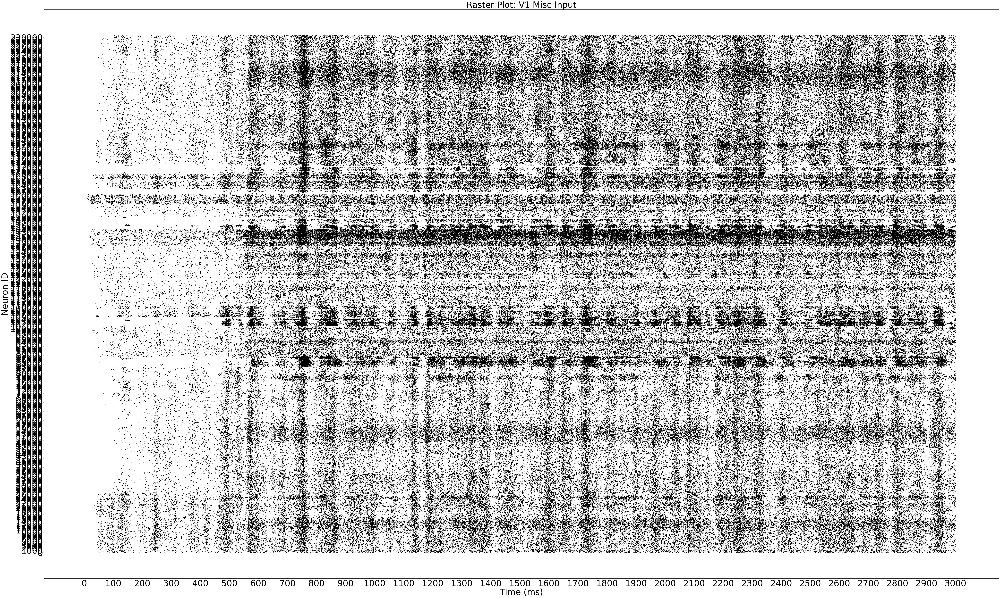

In [10]:
raster_plot_scatter(df=full_pointnet_spikes_trial_0, title='Raster Plot: V1 Misc Input',
                   save_dir='./plots/v1_other/',
                       save_title='V1_misc.png')

(0, 3000)


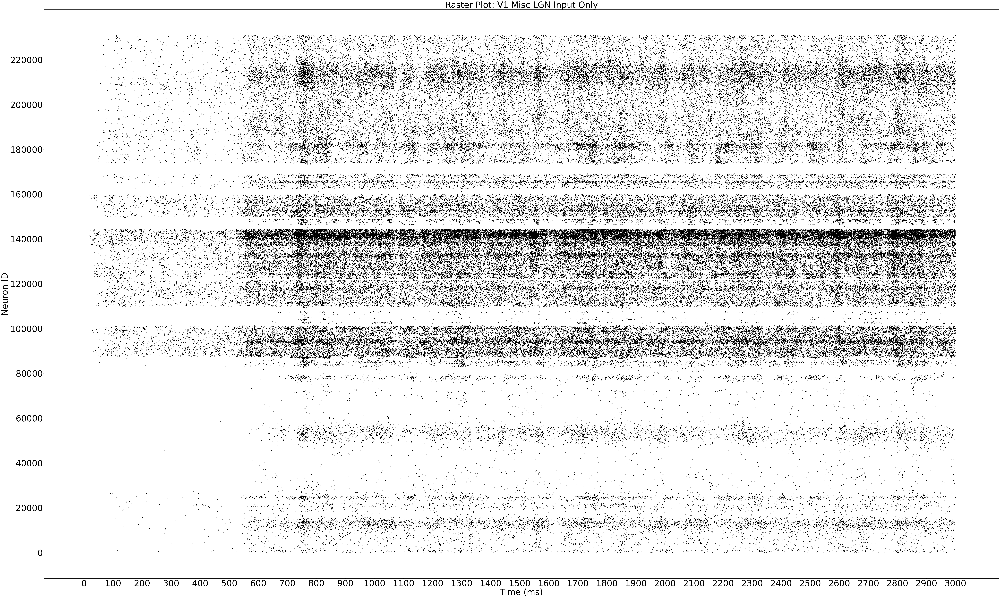

In [21]:
full_pointnet_spikes_trial_0 = to_dataframe(config_file=None, spikes_file=\
                                            '../pointnet_v1/output/no_bg_input_lgn_input_only/spikes.h5')
full_pointnet_spikes_trial_0

raster_plot_scatter(df=full_pointnet_spikes_trial_0, title='Raster Plot: V1 Misc LGN Input Only',
                   save_dir='./plots/v1_other/',
                       save_title='V1_misc_lgn_no_bg_input.png')

(0, 3000)


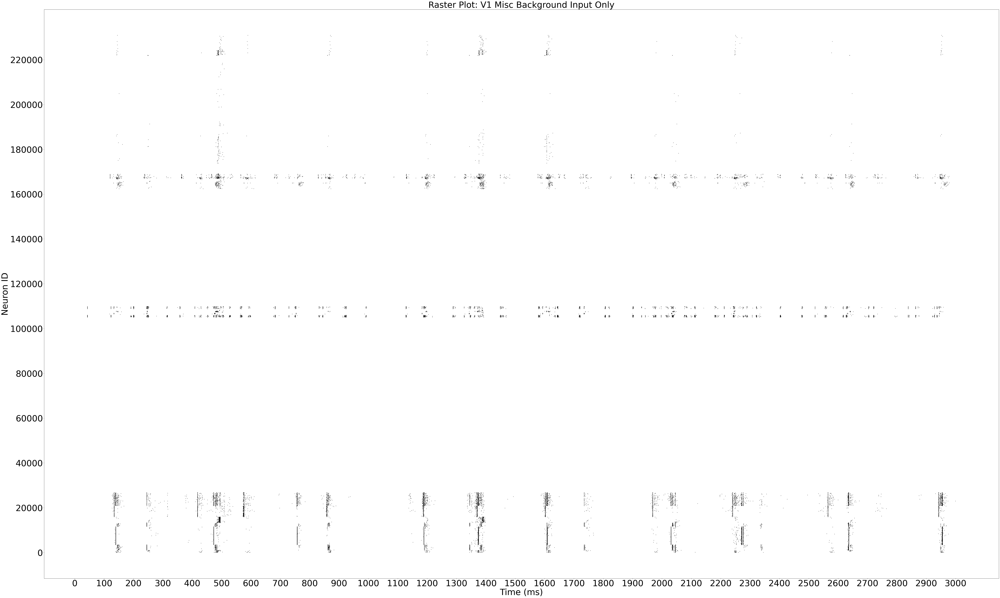

In [20]:
full_pointnet_spikes_trial_0 = to_dataframe(config_file=None, spikes_file=\
                                            '../pointnet_v1/output/no_lgn_input_background_input_only/spikes.h5')
full_pointnet_spikes_trial_0

raster_plot_scatter(df=full_pointnet_spikes_trial_0, title='Raster Plot: V1 Misc Background Input Only',
                   save_dir='./plots/v1_other/',
                       save_title='V1_bg_input_only.png')

In [ ]:
#NO INPUTS AT ALL DOESN'T PLOT BECAUSE THE spikes.h5 FILE IS EMPTY
"""
full_pointnet_spikes_trial_0 = to_dataframe(config_file=None, spikes_file=\
                                            '../pointnet_v1/output/no_lgn_or_background_input/spikes.h5')
full_pointnet_spikes_trial_0

raster_plot_scatter(df=full_pointnet_spikes_trial_0, title='Raster Plot: V1 No Input',
                   save_dir='./plots/v1_other/',
                       save_title='no_input.png')
"""

(0, 3000)


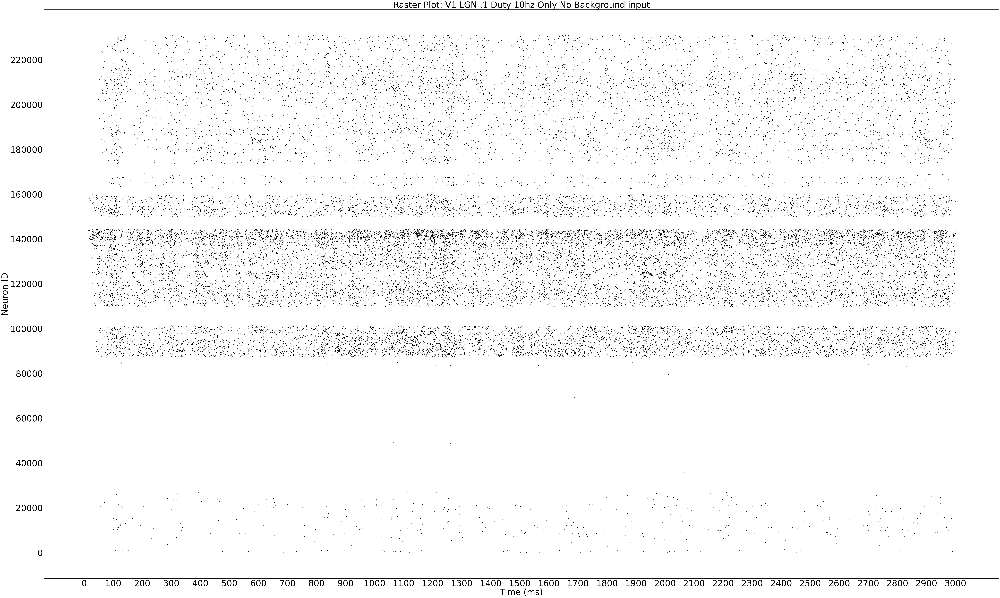

In [19]:
full_pointnet_spikes_trial_0 = to_dataframe(config_file=None, spikes_file=\
                                            '../pointnet_v1/my_results/flicker_10_hz_.1_duty_no_bg_input/spikes.h5')
full_pointnet_spikes_trial_0

raster_plot_scatter(df=full_pointnet_spikes_trial_0, title='Raster Plot: V1 LGN .1 Duty 10hz Only No Background input',
                   save_dir='./plots/v1_other/',
                       save_title='10hz .1 duty No Background Input.png')

(0, 3000)


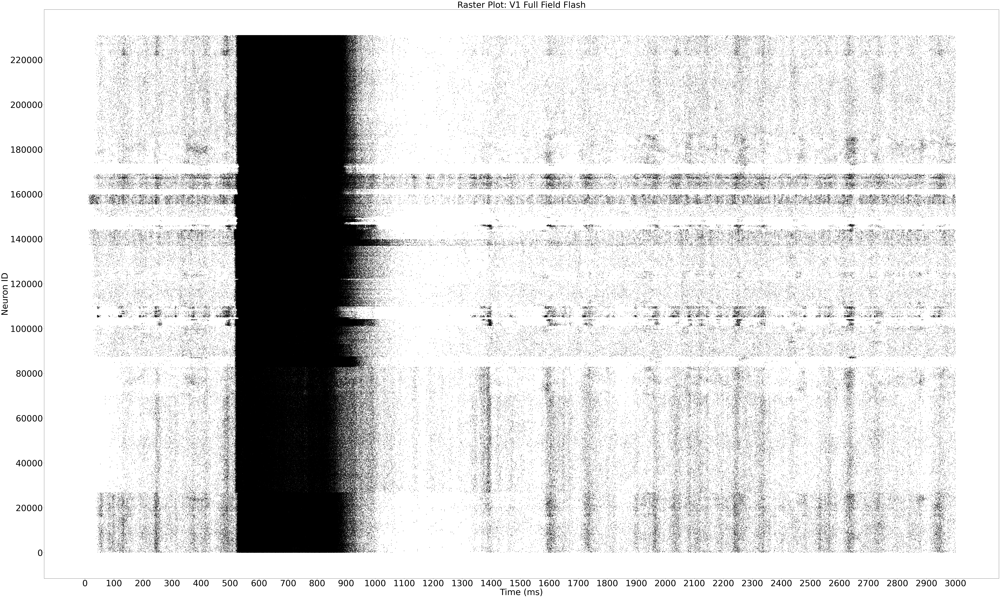

In [18]:
full_pointnet_spikes_trial_0 = to_dataframe(config_file=None, spikes_file=\
                                            '../pointnet_v1/my_results/full_field_flash_first_flash_only/spikes.h5')
full_pointnet_spikes_trial_0

raster_plot_scatter(df=full_pointnet_spikes_trial_0, title='Raster Plot: V1 Full Field Flash',
                   save_dir='./plots/v1_full_field/',
                       save_title='full_field_flash_first_flash_only.png')


(0, 3000)


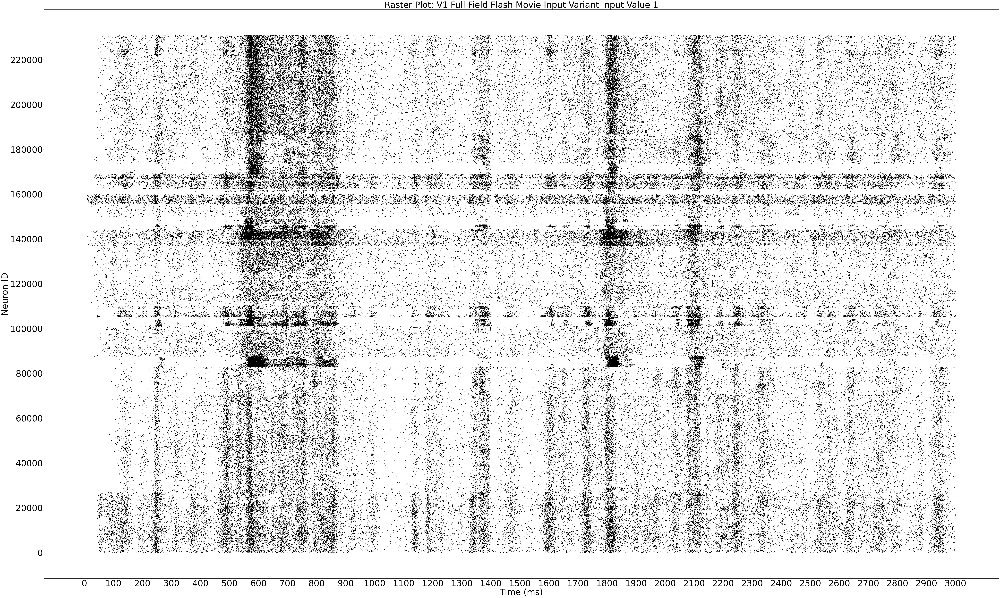

In [17]:
full_pointnet_spikes_trial_0 = to_dataframe(config_file=None, spikes_file=\
                                            '../pointnet_v1/my_results/full_field_flash_movie_intensity_1/spikes.h5')
full_pointnet_spikes_trial_0

raster_plot_scatter(df=full_pointnet_spikes_trial_0, title='Raster Plot: V1 Full Field Flash Movie Input Variant Input Value 1',
                   save_dir='./plots/v1_full_field/',
                       save_title='full_field_flash_movie_input_variant_input_value_1.png')

(0, 3000)


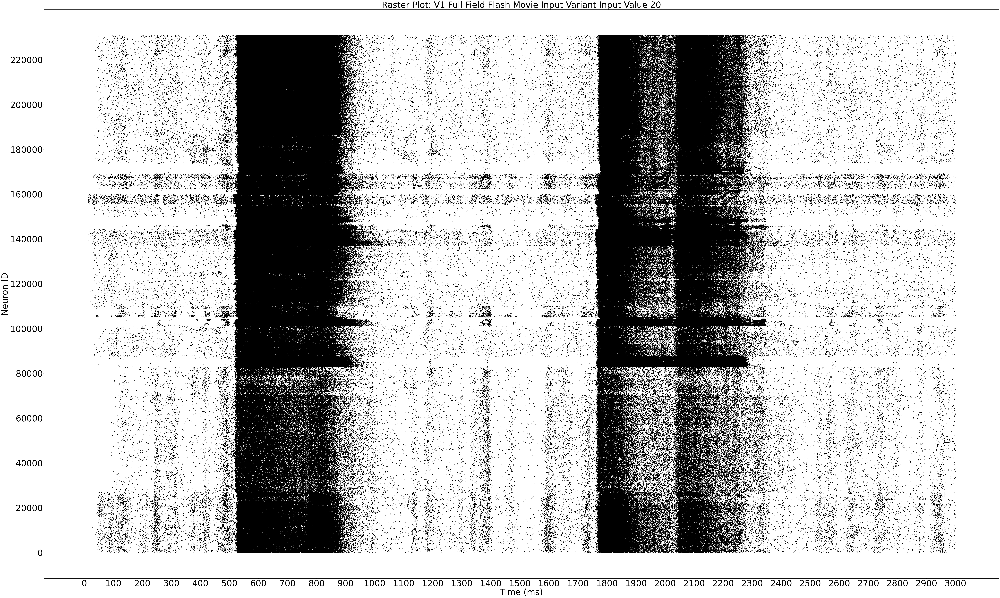

In [16]:
full_pointnet_spikes_trial_0 = to_dataframe(config_file=None, spikes_file=\
                                            '../pointnet_v1/my_results/full_field_flash_movie_intensity_20/spikes.h5')
full_pointnet_spikes_trial_0

raster_plot_scatter(df=full_pointnet_spikes_trial_0, title='Raster Plot: V1 Full Field Flash Movie Input Variant Input Value 20',
                   save_dir='./plots/v1_full_field/',
                       save_title='full_field_flash_movie_input_variant_input_value_20.png')

(0, 3000)


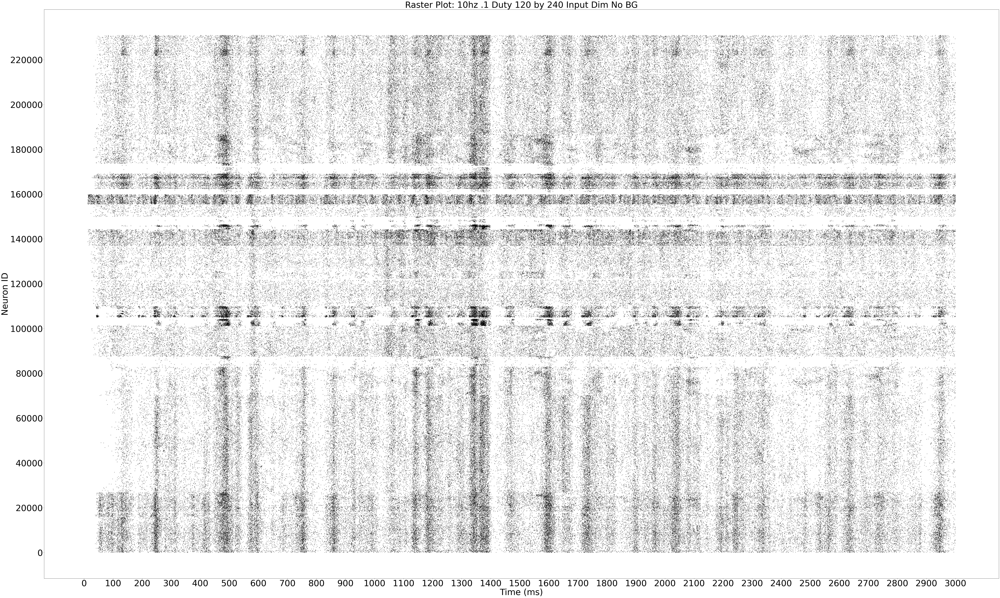

In [15]:
full_pointnet_spikes_trial_0 = to_dataframe(config_file=None, spikes_file=\
                                            '../pointnet_v1/my_results/flicker_10hz_.1_duty_120_by_240/spikes.h5')
full_pointnet_spikes_trial_0

raster_plot_scatter(df=full_pointnet_spikes_trial_0, title='Raster Plot: 10hz .1 Duty 120 by 240 Input Dim No BG',
                   save_dir='./plots/v1_10hz_.1_duty_120_by_240_input/',
                       save_title='10hz .1 duty 120 by 240 Input Size No Background Input.png')

(0, 3000)


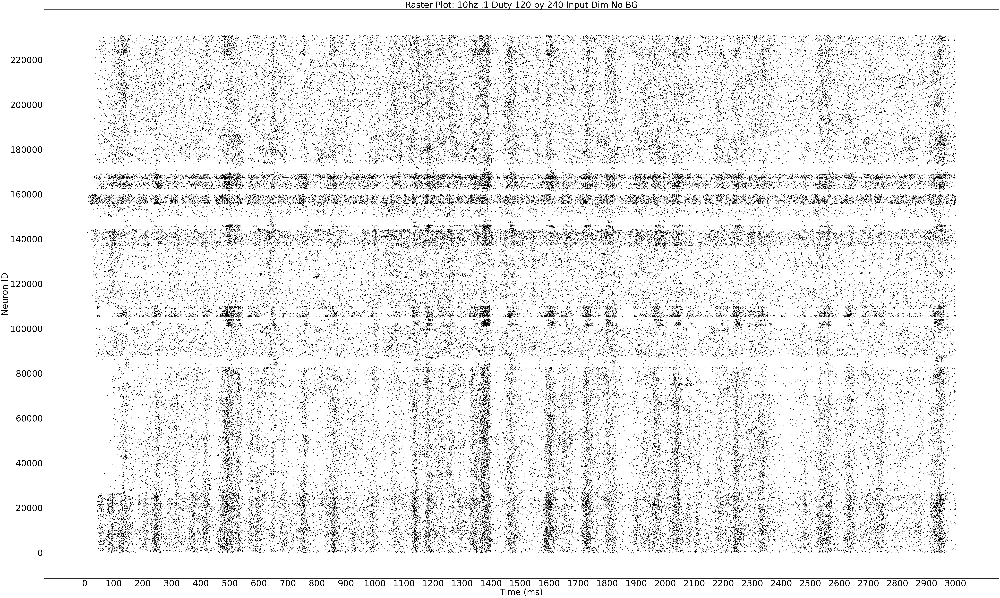

In [14]:
full_pointnet_spikes_trial_0 = to_dataframe(config_file=None, spikes_file=\
                                            '../pointnet_v1/my_results/flicker_10hz_.1_duty_240_by_120/spikes.h5')
full_pointnet_spikes_trial_0

raster_plot_scatter(df=full_pointnet_spikes_trial_0, title='Raster Plot: 10hz .1 Duty 120 by 240 Input Dim No BG',
                   save_dir='./plots/v1_10hz_.1_duty_240_by_120_input/',
                       save_title='10hz .1 duty 240 by 120 Input Size No Background Input.png')